# Gráfico

In [66]:
library("fredr")
library("tidyverse")
library("scales")
library("vroom")
library("ggplot2")
library("dplyr")
library("scales")
library("zoo")
library("gapminder")
library("gganimate")
library("utf8")
library("gridExtra")
library("socviz")
library("ggrepel")
Sys.setlocale("LC_ALL", "pt_br.utf-8")
library("lubridate")
library("readr")
library("ggthemes")
library("maps")
library("ggpomological")
library("ggthemr")
library("extrafont")
library("stringr")


[1] "pt_br.utf-8/pt_br.utf-8/pt_br.utf-8/C/pt_br.utf-8/C"

theme_solarized() <br>
theme_pomological() <br>
scale_colour_solarized() <br>
theme_wsj()

In [67]:
# obs:
# mudança na escala feita da seguinte maneira:
options(repr.plot.width=15, repr.plot.height=8)

In [68]:
# font_import()

In [69]:
runners_data = read.csv("Runners.csv")
glimpse(runners_data)

Rows: 18,244
Columns: 10
$ Rank          <int> 1, 2, 3, 4, 5, 6, 7, 8, 9, 9, 9, 12, 13, 14, 15, 16, 17,…
$ Time          <chr> "00:01:40.910000", "00:01:41.010000", "00:01:41.090000",…
$ Name          <chr> "David Rudisha", "David Rudisha", "David Rudisha", "Wils…
$ Country       <chr> "KEN", "KEN", "KEN", "DEN", "DEN", "KEN", "KEN", "KEN", …
$ Date.of.Birth <chr> "1988-12-17", "1988-12-17", "1988-12-17", "1970-12-12", …
$ Place         <int> 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1,…
$ City          <chr> "London", "Rieti", "Berlin", "Köln", "Zürich", "Rieti", …
$ Date          <chr> "2012-09-08", "2010-08-29", "2010-08-22", "1997-08-24", …
$ Gender        <chr> "Men", "Men", "Men", "Men", "Men", "Men", "Men", "Men", …
$ Event         <chr> "800 m", "800 m", "800 m", "800 m", "800 m", "800 m", "8…


In [70]:
runners_data$Date <- as.POSIXct(runners_data$Date, format = "%Y-%m-%d")
head(runners_data)

,Rank,Time,Name,Country,Date.of.Birth,Place,City,Date,Gender,Event
,<int>,<chr>,<chr>,<chr>,<chr>,<int>,<chr>,<dttm>,<chr>,<chr>
1,1,00:01:40.910000,David Rudisha,KEN,1988-12-17,1,London,2012-09-08,Men,800 m
2,2,00:01:41.010000,David Rudisha,KEN,1988-12-17,1,Rieti,2010-08-29,Men,800 m
3,3,00:01:41.090000,David Rudisha,KEN,1988-12-17,1,Berlin,2010-08-22,Men,800 m
4,4,00:01:41.110000,Wilson Kipketer,DEN,1970-12-12,1,Köln,1997-08-24,Men,800 m
5,5,00:01:41.240000,Wilson Kipketer,DEN,1970-12-12,1,Zürich,1997-08-13,Men,800 m
6,6,00:01:41.330000,David Rudisha,KEN,1988-12-17,1,Rieti,2011-10-09,Men,800 m


In [71]:
runners_data <- runners_data |>
mutate(
    Age = year(runners_data$Date) - year(runners_data$Date.of.Birth	)
)
glimpse(runners_data)

Rows: 18,244
Columns: 11
$ Rank          <int> 1, 2, 3, 4, 5, 6, 7, 8, 9, 9, 9, 12, 13, 14, 15, 16, 17,…
$ Time          <chr> "00:01:40.910000", "00:01:41.010000", "00:01:41.090000",…
$ Name          <chr> "David Rudisha", "David Rudisha", "David Rudisha", "Wils…
$ Country       <chr> "KEN", "KEN", "KEN", "DEN", "DEN", "KEN", "KEN", "KEN", …
$ Date.of.Birth <chr> "1988-12-17", "1988-12-17", "1988-12-17", "1970-12-12", …
$ Place         <int> 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1,…
$ City          <chr> "London", "Rieti", "Berlin", "Köln", "Zürich", "Rieti", …
$ Date          <dttm> 2012-09-08, 2010-08-29, 2010-08-22, 1997-08-24, 1997-08…
$ Gender        <chr> "Men", "Men", "Men", "Men", "Men", "Men", "Men", "Men", …
$ Event         <chr> "800 m", "800 m", "800 m", "800 m", "800 m", "800 m", "8…
$ Age           <dbl> 24, 22, 22, 27, 27, 23, 22, 24, 25, 27, 18, 24, 21, 26, …


In [72]:
color_per_gender <- c("Men" = "#2986cc", "Women" = "#d5a6bd")
color_per_medal <- c("Gold_medals" = "#D6AF36", "Silver_medals"= "#A7A7AD", "Bronze_medals" = "#A77044")

# Performance entre sexo

Vamos começar analisando a performace entre homens e mulhes

In [73]:
runners_women <- runners_data |>
filter(Gender == "Women")

runners_men <- runners_data |>
filter(Gender == "Men")

runners_men$Year <- year(runners_men$Date)
runners_women$Year <- year(runners_women$Date)
runners_data$Year <- year(runners_data$Date)

In [74]:
glimpse(runners_data)

Rows: 18,244
Columns: 12
$ Rank          <int> 1, 2, 3, 4, 5, 6, 7, 8, 9, 9, 9, 12, 13, 14, 15, 16, 17,…
$ Time          <chr> "00:01:40.910000", "00:01:41.010000", "00:01:41.090000",…
$ Name          <chr> "David Rudisha", "David Rudisha", "David Rudisha", "Wils…
$ Country       <chr> "KEN", "KEN", "KEN", "DEN", "DEN", "KEN", "KEN", "KEN", …
$ Date.of.Birth <chr> "1988-12-17", "1988-12-17", "1988-12-17", "1970-12-12", …
$ Place         <int> 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1,…
$ City          <chr> "London", "Rieti", "Berlin", "Köln", "Zürich", "Rieti", …
$ Date          <dttm> 2012-09-08, 2010-08-29, 2010-08-22, 1997-08-24, 1997-08…
$ Gender        <chr> "Men", "Men", "Men", "Men", "Men", "Men", "Men", "Men", …
$ Event         <chr> "800 m", "800 m", "800 m", "800 m", "800 m", "800 m", "8…
$ Age           <dbl> 24, 22, 22, 27, 27, 23, 22, 24, 25, 27, 18, 24, 21, 26, …
$ Year          <dbl> 2012, 2010, 2010, 1997, 1997, 2011, 2010, 2012, 1981, 19…


In [75]:
performance_runners_men <- runners_men |>
group_by(Year) |>
filter(Year <= 2016) |>
summarise(
    Gold_medals = sum(Place == 1,na.rm = TRUE),
    Silver_medals = sum(Place == 2,na.rm = TRUE),
    Bronze_medals = sum(Place == 3,na.rm = TRUE),
    Total = Gold_medals + Silver_medals + Bronze_medals
)
glimpse(performance_runners_men)

Rows: 52
Columns: 5
$ Year          <dbl> 1962, 1965, 1966, 1967, 1968, 1969, 1971, 1972, 1973, 19…
$ Gold_medals   <int> 1, 1, 1, 2, 7, 1, 2, 5, 3, 10, 7, 7, 16, 14, 14, 15, 18,…
$ Silver_medals <int> 0, 0, 0, 0, 4, 0, 0, 2, 0, 1, 0, 3, 4, 2, 0, 3, 1, 8, 7,…
$ Bronze_medals <int> 0, 0, 0, 0, 3, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 2, 4,…
$ Total         <int> 1, 1, 1, 2, 14, 1, 2, 7, 3, 12, 7, 11, 21, 17, 14, 19, 1…


In [76]:
performance_runners_women <- runners_women |>
group_by(Year) |>
filter(Year <= 2016) |>
summarise(
    Gold_medals = sum(Place == 1,na.rm = TRUE),
    Silver_medals = sum(Place == 2,na.rm = TRUE),
    Bronze_medals = sum(Place == 3,na.rm = TRUE),
    Total = Gold_medals + Silver_medals + Bronze_medals
)
glimpse(performance_runners_women)

Rows: 45
Columns: 5
$ Year          <dbl> 1964, 1972, 1973, 1974, 1976, 1977, 1978, 1979, 1980, 19…
$ Gold_medals   <int> 1, 2, 3, 8, 28, 12, 22, 47, 59, 49, 59, 62, 119, 78, 90,…
$ Silver_medals <int> 0, 1, 0, 0, 13, 2, 8, 13, 27, 15, 18, 26, 54, 33, 30, 30…
$ Bronze_medals <int> 0, 0, 0, 0, 7, 0, 5, 7, 16, 8, 9, 12, 25, 11, 8, 14, 26,…
$ Total         <int> 1, 3, 3, 8, 48, 14, 35, 67, 102, 72, 86, 100, 198, 122, …


`geom_smooth()` using method = 'loess' and formula = 'y ~ x'


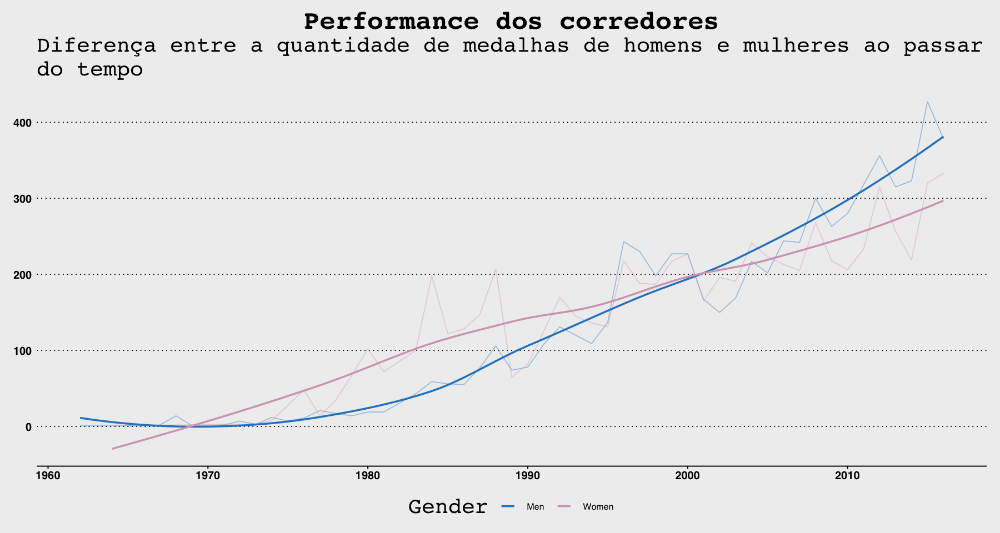

In [77]:
performance_runners_men$Gender <- "Men"
performance_runners_women$Gender <- "Women"
combined_data_performance_runners <- rbind(performance_runners_men, performance_runners_women)
subtitle_text <- "Diferença entre a quantidade de medalhas de homens e mulheres ao passar do tempo"
wrapped_subtitle <- str_wrap(subtitle_text, width = 73)  

ggplot(data = combined_data_performance_runners, aes(x = Year, y = Total, color = Gender)) + geom_line(alpha = 0.4) + scale_x_continuous(breaks = seq(1960, 2015, 10)) +
geom_smooth(se = FALSE) + theme_wsj(color = "gray") + scale_color_manual(values = color_per_gender)  +
labs(
    title = "Performance dos corredores",
    subtitle = wrapped_subtitle
) + theme(
    plot.title = element_text(hjust = 0.5),
    legend.position = "bottom"
)

In [78]:
subtitle_text <- "Separando o desempenho dos competidores em categorias de medalhas conquistadas,ouro,prata e bronze, respectivamente"
wrapped_subtitle <- str_wrap(subtitle_text, width = 120)  
gold_medal_plot <- ggplot(data = combined_data_performance_runners, mapping = aes(y = Gold_medals, x  = Year,color = Gender)) + geom_line() + theme_wsj(color = "gray") +
scale_color_manual(values = color_per_gender) + labs(
    title  = "Medalhas entre homens e mulheres",
     subtitle = wrapped_subtitle
)  + theme(
    plot.title = element_text(hjust = 0.5,size = 15),
    plot.subtitle = element_text(size = 15)
) + guides(color = FALSE)

In [79]:
silver_medal_plot <- ggplot(data = combined_data_performance_runners, mapping = aes(y = Silver_medals, x  = Year,color = Gender)) + geom_line() + theme_wsj(color = "gray") + guides(color = FALSE)+ 
scale_color_manual(values = color_per_gender) + labs(
    y = "medalhas de prata"
)


In [80]:
bronze_medal_plot <- ggplot(data = combined_data_performance_runners, mapping = aes(y = Silver_medals, x  = Year,color = Gender)) + geom_line() + theme_wsj(color = "gray") + 
scale_color_manual(values = color_per_gender) + labs(
    y = "medalhas de bronze"
) + theme(
    legend.position = "bottom"
)

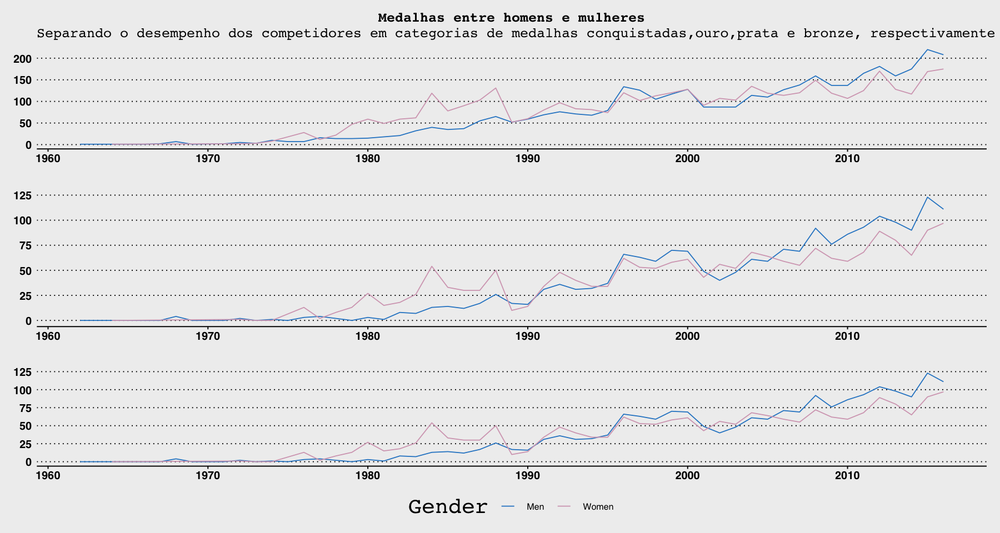

In [81]:
grid.arrange(gold_medal_plot,silver_medal_plot,bronze_medal_plot)

In [82]:
head(combined_data_performance_runners)

Year,Gold_medals,Silver_medals,Bronze_medals,Total,Gender
<dbl>,<int>,<int>,<int>,<int>,<chr>
1962,1,0,0,1,Men
1965,1,0,0,1,Men
1966,1,0,0,1,Men
1967,2,0,0,2,Men
1968,7,4,3,14,Men
1969,1,0,0,1,Men


In [83]:
subtitle_text <- "Separando o desempenho dos competidores em categorias de medalhas conquistadas,ouro,prata e bronze, respectivamente"
wrapped_subtitle <- str_wrap(subtitle_text, width = 120)  

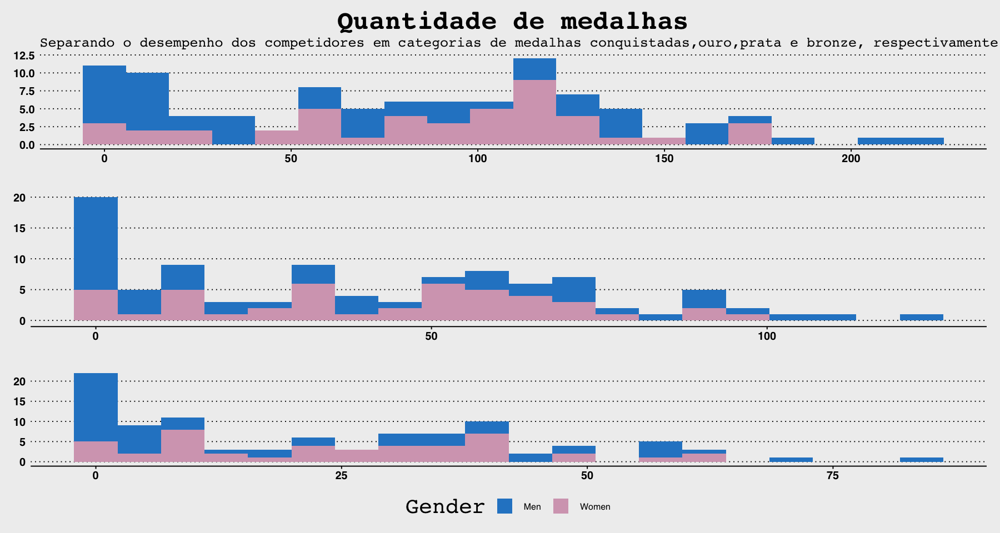

In [84]:
gold_medal_plot  <- ggplot(data = combined_data_performance_runners,mapping = aes(x = Gold_medals, fill = Gender)) + geom_histogram(bins = 20) + theme_wsj(color = "gray") + 
scale_color_manual(values = color_per_gender) + scale_fill_manual(values = color_per_gender)+ guides(fill = FALSE) + labs(title = "Quantidade de medalhas",subtitle = wrapped_subtitle) + 
theme(plot.title = element_text(hjust = 0.5),plot.subtitle = element_text(size = 15))

silver_medal_plot <- ggplot(data = combined_data_performance_runners,mapping = aes(x = Silver_medals, fill = Gender)) + geom_histogram(bins = 20) + theme_wsj(color = "gray") + guides(fill = FALSE) + scale_fill_manual(values = color_per_gender)

bronze_medal_plot <- ggplot(data = combined_data_performance_runners,mapping = aes(x = Bronze_medals, fill = Gender)) + geom_histogram(bins = 20) + theme_wsj(color = "gray")  + scale_fill_manual(values = color_per_gender) + theme(legend.position = "bottom")

grid.arrange(gold_medal_plot,silver_medal_plot,bronze_medal_plot)

## Performance por país 

In [85]:
performance_country <- runners_data |>
filter(Place == 1 | Place == 2 | Place == 3) |>
count(Country,sort = TRUE)

performance_country_filtered <- head(performance_country$Country,9)
performance_country_filtered <- as.list(performance_country_filtered)

In [86]:
countries_performance_per_year <- runners_data |>
group_by(Country,Year) |>
filter(Place == 1 | Place == 2 | Place == 3, Year <= 2016) |>
count(Country,sort =  TRUE) |>
rename(total = n)  

top_countries_performance_per_year <- countries_performance_per_year |> filter(Country %in% performance_country_filtered)

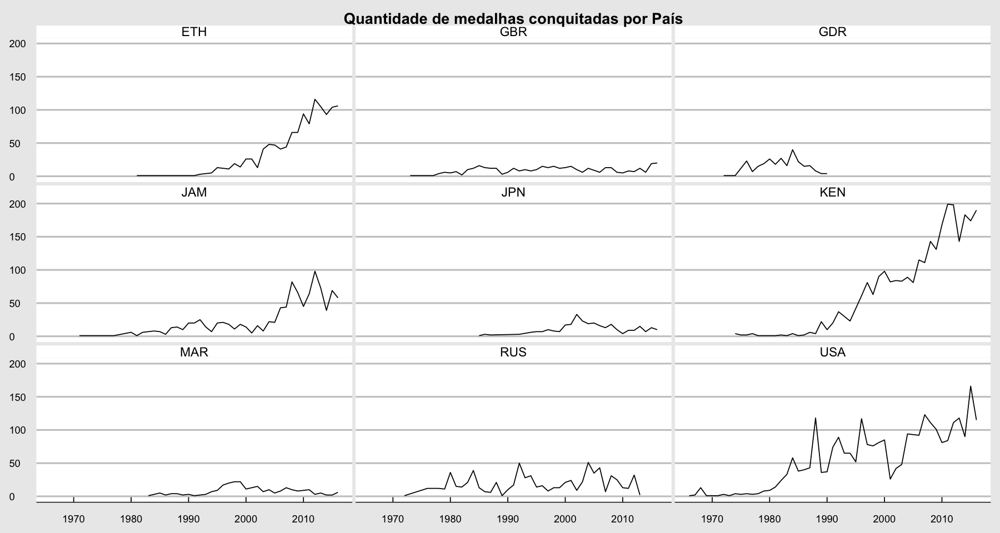

In [87]:
subtitle_text <- "Diferença entre a quantidade de medalhas dos países ao passar do tempo"
wrapped_subtitle <- str_wrap(subtitle_text, width = 73)  

ggplot(data = top_countries_performance_per_year, mapping = aes(x = Year, y = total)) + geom_line(mapping = aes(group = Country)) + 
facet_wrap(~Country, ncol = 3)  + theme_economist_white() + 
labs(title = "Quantidade de medalhas conquitadas por País", x = NULL, y = NULL) + 
theme(plot.title = element_text(hjust = 0.5), )

In [88]:
performance_country_by_sex <- runners_data |>
group_by(Country,Gender,Year) |>
filter(Place == 1 | Place == 2 | Place == 3, Year <= 2016) |>
count(Gender,sort =  TRUE) |>
rename(total = n) 
top_performance_country_by_sex <- performance_country_by_sex |> filter(Country %in% performance_country_filtered)

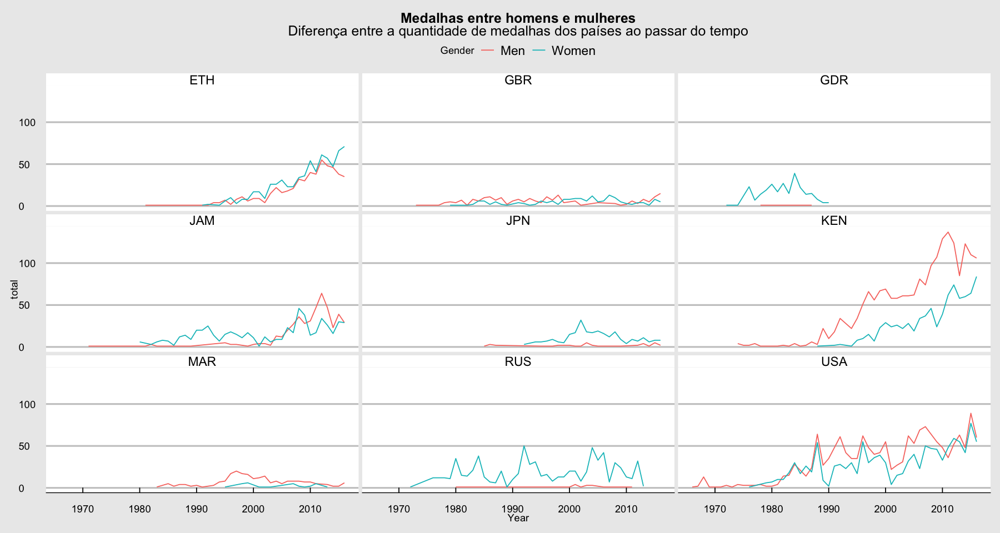

In [89]:
ggplot(data = top_performance_country_by_sex, mapping = aes(x = Year, y = total,color = Gender)) + geom_line() + 
facet_wrap(~Country, ncol = 3) + theme_economist_white() + 
labs(
    title  = "Medalhas entre homens e mulheres",
     subtitle = wrapped_subtitle
)  + theme(
    plot.title = element_text(hjust = 0.5,size = 15),
    plot.subtitle = element_text(size = 15)
)


In [90]:
performance_runners_men <- runners_men |>
group_by(Country) |>
filter(Year <= 2016) |>
summarise(
    Gold_medals = sum(Place == 1,na.rm = TRUE),
    Silver_medals = sum(Place == 2,na.rm = TRUE),
    Bronze_medals = sum(Place == 3,na.rm = TRUE),
    Total = Gold_medals + Silver_medals + Bronze_medals
)

In [91]:
performance_runners_men <- performance_runners_men |>
pivot_longer(
  cols = c(Gold_medals, Silver_medals, Bronze_medals),
  names_to = "Medal",
  values_to = "Count"
)
performance_runners_men <-as.data.frame(performance_runners_men)
performance_runners_men <- performance_runners_men |> filter(Country %in% performance_country_filtered)

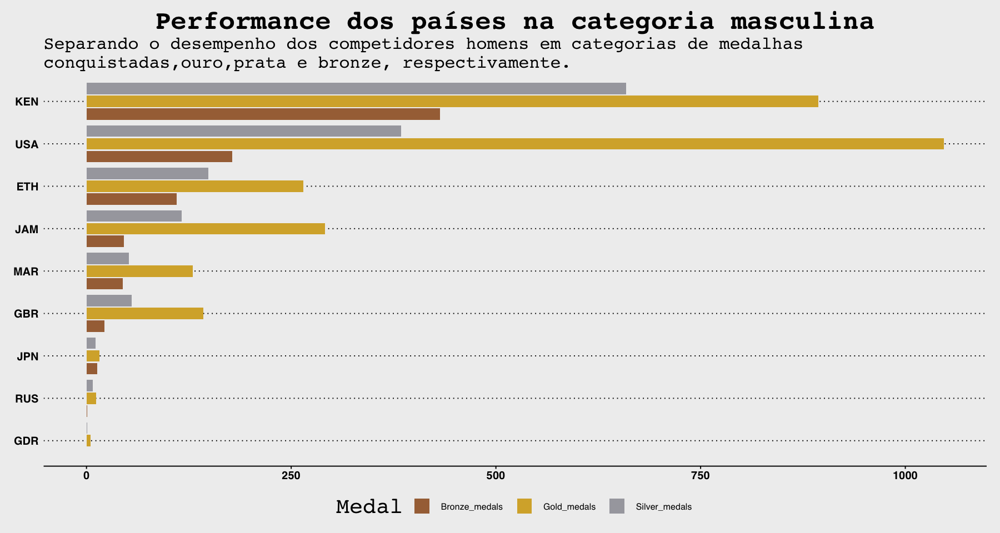

In [92]:
subtitle_text <- "Separando o desempenho dos competidores homens em categorias de medalhas conquistadas,ouro,prata e bronze, respectivamente."
wrapped_subtitle <- str_wrap(subtitle_text, width = 95) 
ggplot(data = performance_runners_men, mapping = aes(x = reorder(Country,Count), y = Count,fill = Medal)) + 
geom_bar(stat = "identity",position = "dodge2") + coord_flip() + theme_wsj(color = "gray") + scale_fill_manual(values = color_per_medal) +
theme(
    legend.position = "bottom"
) + labs(
    title = "Performance dos países na categoria masculina",
    subtitle = wrapped_subtitle
) + theme(plot.title = element_text(hjust = 0.5),plot.subtitle = element_text(size = 19))

In [93]:
performance_runners_women <- runners_women|>
group_by(Country) |>
filter(Year <= 2016) |>
summarise(
    Gold_medals = sum(Place == 1,na.rm = TRUE),
    Silver_medals = sum(Place == 2,na.rm = TRUE),
    Bronze_medals = sum(Place == 3,na.rm = TRUE),
    Total = Gold_medals + Silver_medals + Bronze_medals
)

In [94]:
performance_runners_women <- performance_runners_women |>
pivot_longer(
  cols = c(Gold_medals, Silver_medals, Bronze_medals),
  names_to = "Medal",
  values_to = "Count"
)
performance_runners_women <-as.data.frame(performance_runners_women)
performance_runners_women <- performance_runners_women |> filter(Country %in% performance_country_filtered)

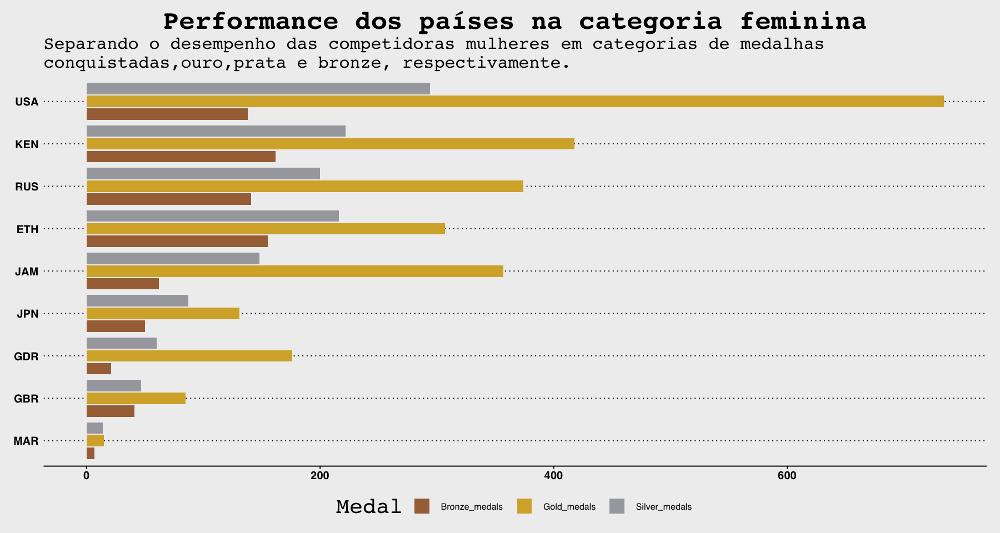

In [95]:
subtitle_text <- "Separando o desempenho das competidoras mulheres em categorias de medalhas conquistadas,ouro,prata e bronze, respectivamente."
wrapped_subtitle <- str_wrap(subtitle_text, width = 95) 
ggplot(data = performance_runners_women, mapping = aes(x = reorder(Country,Count), y = Count,fill = Medal)) + 
geom_bar(stat = "identity",position = "dodge2") + coord_flip() + theme_wsj(color = "gray") + scale_fill_manual(values = color_per_medal) +
theme(
    legend.position = "bottom"
) + labs(
    title = "Performance dos países na categoria feminina",
    subtitle = wrapped_subtitle
) + theme(plot.title = element_text(hjust = 0.5),plot.subtitle = element_text(size = 19))

## Relação entre a idade e velocidade

In [96]:
fastest_time <- runners_data |>
group_by(Time,Age) |>
arrange(Time,sort = TRUE)

temp_list <- c()
temp_list_1 <- c("Age<=20","20<Age<25","25<Age<30","30<Age<35","Age>=35")
 
temp_list <- append(temp_list,fastest_time |> filter(Age <= 20) |> nrow())
temp_list <- append(temp_list,fastest_time |> filter(Age <= 25 & Age >= 20 ) |> nrow())
temp_list <- append(temp_list,fastest_time |> filter(Age <= 30 & Age >= 25 ) |> nrow())
temp_list <- append(temp_list,fastest_time |> filter(Age <= 35 & Age >= 30 ) |> nrow())
temp_list <- append(temp_list,fastest_time |> filter(Age >= 35) |> nrow())

fastest_time <- data.frame(Age = temp_list_1,Total = temp_list)

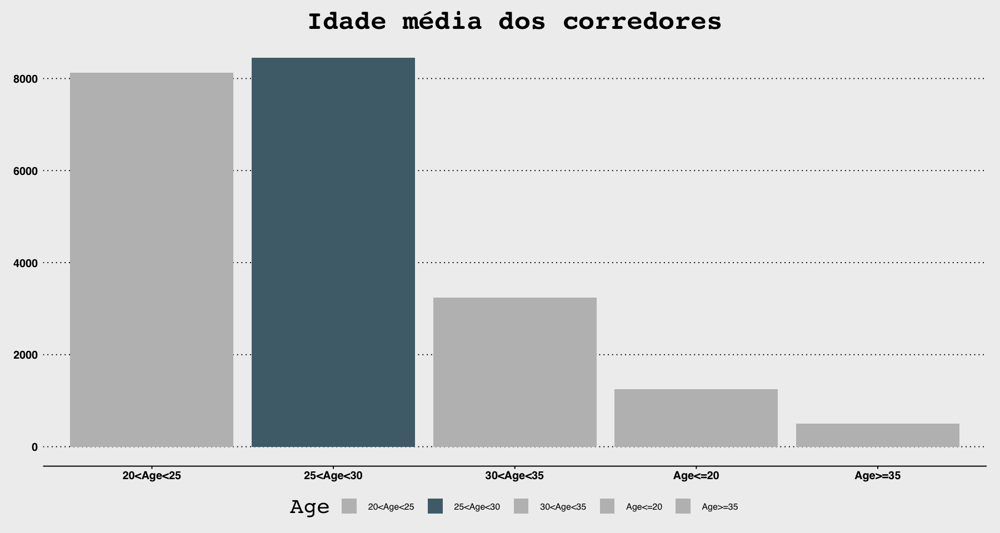

In [97]:
ggplot(data = fastest_time, mapping = aes(x = Age, y = Total, fill = Age)) +
  geom_bar(stat = "identity") +
  scale_fill_manual(values = c("gray", "#4F6D7A", "gray","gray","gray")) +
  theme_wsj(color = "gray") +
  labs(title = "Idade média dos corredores") +
  theme(plot.title = element_text(hjust = 0.5),legend.position = "bottom")

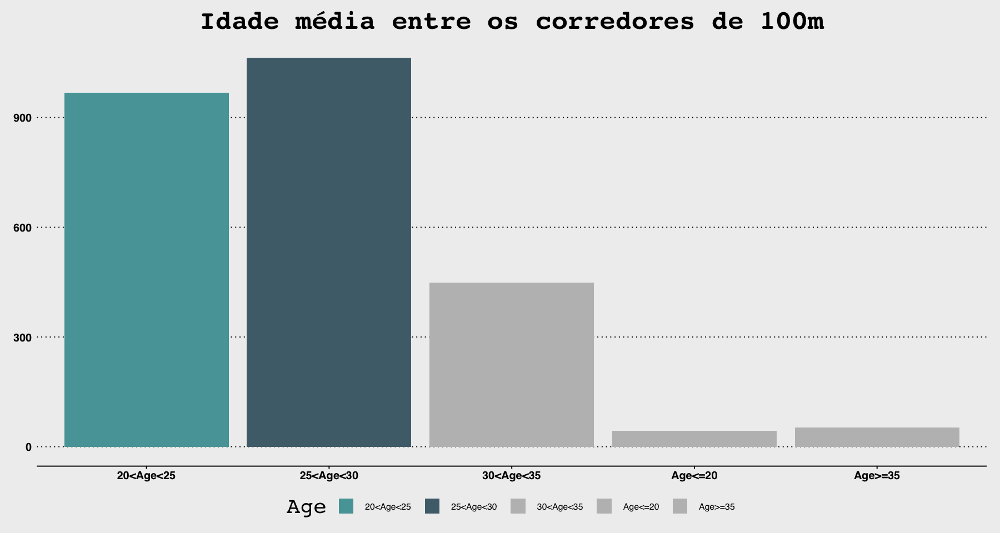

In [98]:
fastest_time <- runners_data |>
group_by(Time,Age) |>
filter(Event == "100 m") |>
arrange(Time,sort = TRUE)

mean_100m <- mean(fastest_time$Age)
temp_list <- c()
temp_list_1 <- c("Age<=20","20<Age<25","25<Age<30","30<Age<35","Age>=35")
 
temp_list <- append(temp_list,fastest_time |> filter(Age <= 20) |> nrow())
temp_list <- append(temp_list,fastest_time |> filter(Age <= 25 & Age >= 20 ) |> nrow())
temp_list <- append(temp_list,fastest_time |> filter(Age <= 30 & Age >= 25 ) |> nrow())
temp_list <- append(temp_list,fastest_time |> filter(Age <= 35 & Age >= 30 ) |> nrow())
temp_list <- append(temp_list,fastest_time |> filter(Age >= 35) |> nrow())

fastest_time <- data.frame(Age = temp_list_1,Total = temp_list)

ggplot(data = fastest_time, mapping = aes(x = Age,fill = Age)) +
  geom_bar(mapping = aes(y = Total), stat = "identity") +
  scale_fill_manual(values = c("#56A3A6", "#4F6D7A","gray","gray","gray")) +
  theme_wsj(color = "gray") +
  labs(title = "Idade média entre os corredores de 100m") + theme(
    plot.title = element_text(hjust = 0.5), 
    legend.position = "bottom"
  )

In [99]:
mean_100m

[1] 26.43839

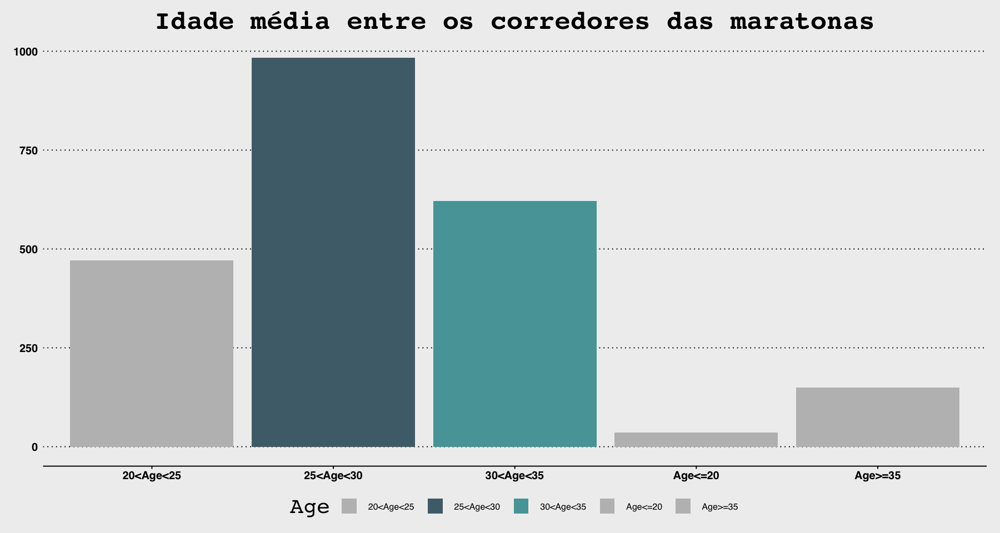

In [100]:
fastest_time <- runners_data |>
group_by(Time,Age) |>
filter(Event == "Marathon") |>
arrange(Time,sort = TRUE) |>
na.omit()

mean_marathon <- mean(fastest_time$Age)
temp_list <- c()
temp_list_1 <- c("Age<=20","20<Age<25","25<Age<30","30<Age<35","Age>=35")
 
temp_list <- append(temp_list,fastest_time |> filter(Age <= 20) |> nrow())
temp_list <- append(temp_list,fastest_time |> filter(Age <= 25 & Age >= 20 ) |> nrow())
temp_list <- append(temp_list,fastest_time |> filter(Age <= 30 & Age >= 25 ) |> nrow())
temp_list <- append(temp_list,fastest_time |> filter(Age <= 35 & Age >= 30 ) |> nrow())
temp_list <- append(temp_list,fastest_time |> filter(Age >= 35) |> nrow())

fastest_time <- data.frame(Age = temp_list_1,Total = temp_list)

ggplot(data = fastest_time, mapping = aes(x = Age, fill = Age)) +
  geom_bar(mapping = aes(y = Total), stat = "identity") +
  scale_fill_manual(values = c("gray", "#4F6D7A","#56A3A6","gray","gray")) +
  theme_wsj(color = "gray") +
  labs(title = "Idade média entre os corredores das maratonas") + theme(
    plot.title = element_text(hjust = 0.5),
    legend.position = "bottom"
    
  )

In [101]:
mean_marathon

[1] 28.39147

## Corredores com a maior quantidade de medalhas

In [102]:
most_medals_men <- runners_men |>
group_by(Name) |>
filter(Place == 1 | Place == 2 | Place == 3) |>
count(Name,sort = TRUE)

most_medals_men <- head(most_medals_men,10)
head(most_medals_men)
most_medals_men_list = as.list(most_medals_men$Name)

Name,n
<chr>,<int>
Michael Johnson,122
Usain Bolt,107
Asafa Powell,106
LaShawn Merritt,97
Frank Fredericks,81
Justin Gatlin,78


Warning message:
“Removed 1 row containing missing values (`geom_line()`).”


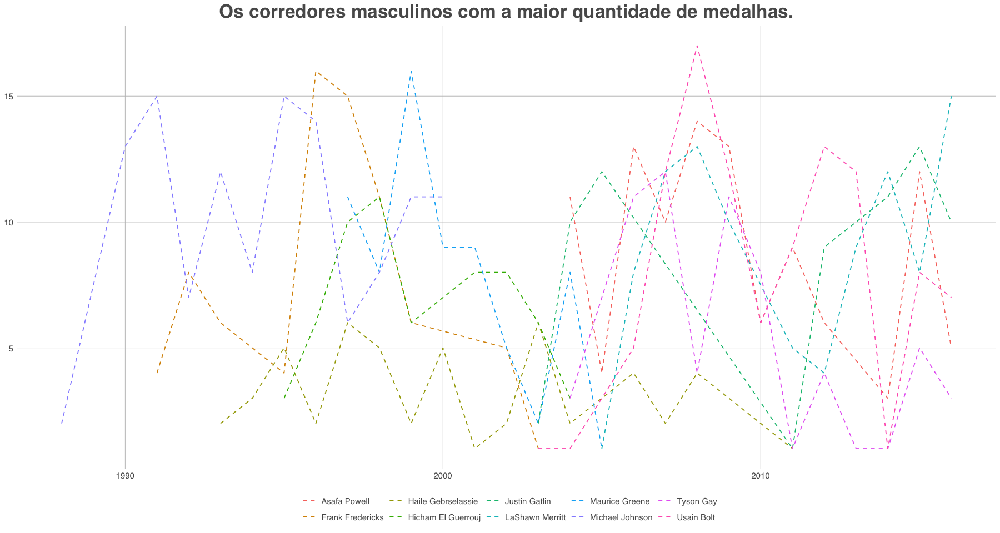

In [103]:
medals_over_time_fastest_men <- runners_men |>
filter(Name %in% most_medals_men_list) |>
group_by(Year) |>
filter(Place == 1 | Place == 2 | Place == 3) |>
count(Name,sort = TRUE)

ggplot(data = medals_over_time_fastest_men, mapping = aes(x = Year, y = n,color = Name)) + geom_line(linetype = "dashed") +
theme_excel_new() +
labs(
    title = "Os corredores masculinos com a maior quantidade de medalhas.",
) + theme(
    plot.title = element_text(hjust = 0.5,size = 20,face = "bold"),
    legend.position = "bottom"
)

Warning message:
“Removed 1 row containing missing values (`geom_line()`).”


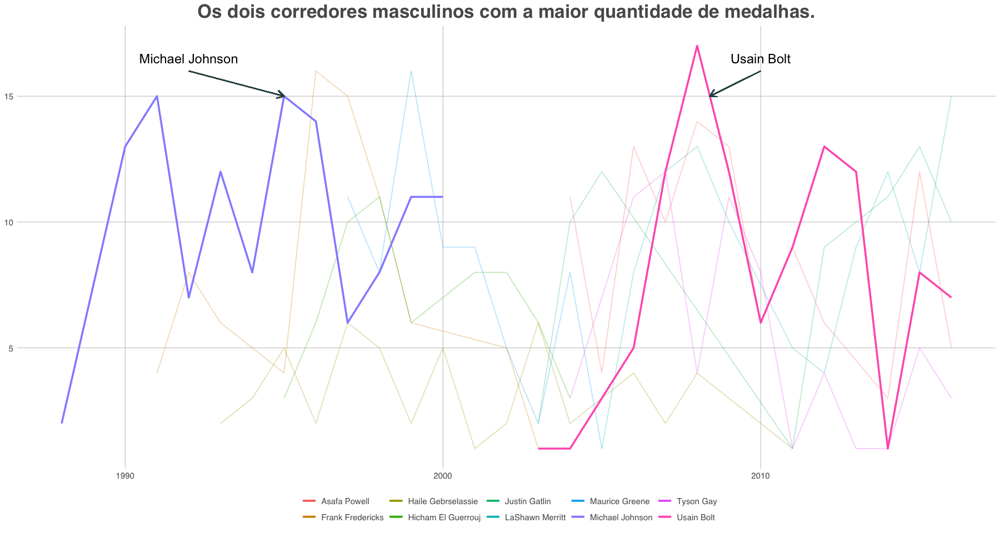

In [104]:
medals_over_time_fastest_men <- runners_men |>
filter(Name %in% most_medals_men_list) |>
group_by(Year) |>
filter(Place == 1 | Place == 2 | Place == 3) |>
count(Name,sort = TRUE)

ggplot(data = medals_over_time_fastest_men, mapping = aes(x = Year, y = n,color = Name)) + geom_line(alpha = 0.3) +
geom_line(data = subset(medals_over_time_fastest_men, Name == "Usain Bolt"), size = 1) +
geom_line(data = subset(medals_over_time_fastest_men, Name == "Michael Johnson"), size = 1) +
theme_excel_new() + annotate("text", x = 1992, y = 16.5, label = "Michael Johnson",size =5) +
geom_segment(
    aes(x = 1992, y =16 , xend = 1995, yend = 15),
    arrow = arrow(length = unit(0.3, "cm")),
    color = "#2E4F4F",
    size = 0.5
)   + annotate("text", x = 2010, y = 16.5, label = "Usain Bolt",size =5) +
geom_segment(
    aes(x = 2010, y = 16 , xend = 2008.4, yend = 15),
    arrow = arrow(length = unit(0.3, "cm")),
    color = "#2E4F4F",
    size = 0.5
)   +
labs(
    title = "Os dois corredores masculinos com a maior quantidade de medalhas.",
) + theme(
    plot.title = element_text(hjust = 0.5,size = 20,face = "bold"),
    legend.position = "bottom"
)

In [105]:
most_medals_women <- runners_women |>
group_by(Name) |>
filter(Place == 1 | Place == 2 | Place == 3) |>
count(Name,sort = TRUE)

most_medals_women <- head(most_medals_women,10)
head(most_medals_women)
most_medals_women_list = as.list(most_medals_women$Name)

Name,n
<chr>,<int>
Merlene Ottey,174
Gwen Torrence,95
Veronica Campbell-Brown,84
Sanya Richards-Ross,83
Maria Mutola,80
Allyson Felix,79


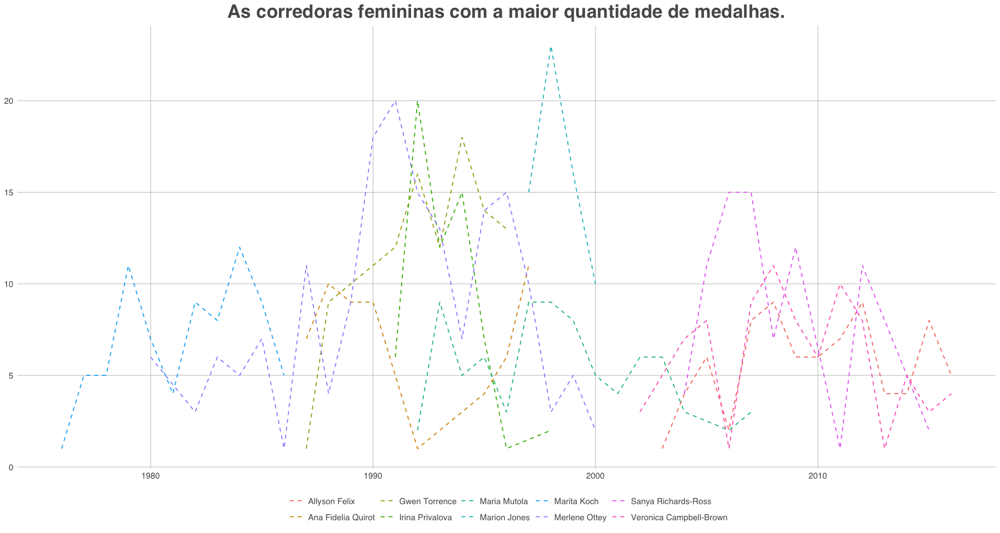

In [106]:
medals_over_time_fastest_women <- runners_women |>
filter(Name %in% most_medals_women_list) |>
group_by(Year) |>
filter(Place == 1 | Place == 2 | Place == 3) |>
count(Name,sort = TRUE)

ggplot(data = medals_over_time_fastest_women, mapping = aes(x = Year, y = n,color = Name)) + geom_line(linetype = "dashed") +
theme_excel_new() +
labs(
    title = "As corredoras femininas com a maior quantidade de medalhas.",
) + theme(
    plot.title = element_text(hjust = 0.5,size = 20,face = "bold"),
    legend.position = "bottom"
)

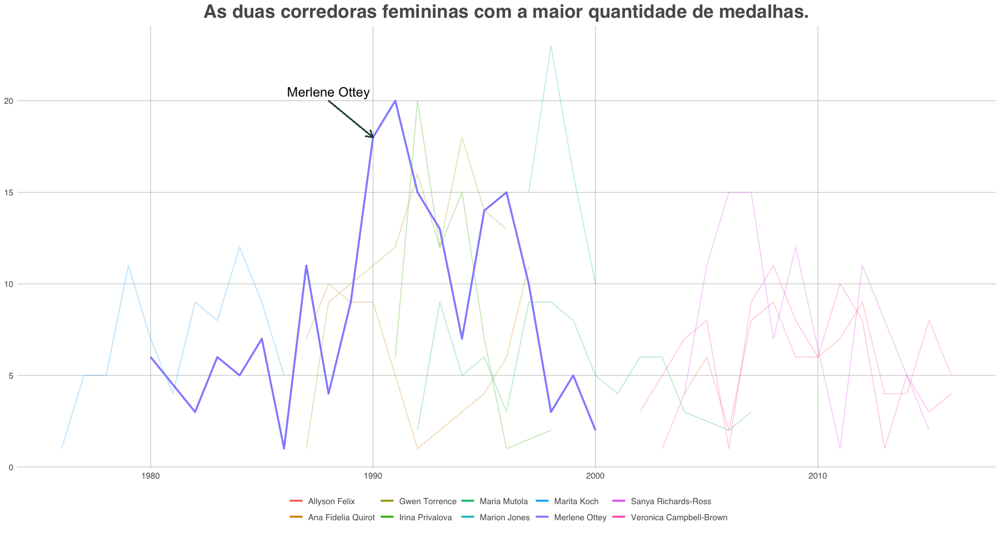

In [107]:
ggplot(data = medals_over_time_fastest_women, mapping = aes(x = Year, y = n,color = Name)) + geom_line(alpha = 0.3) +
geom_line(data = subset(medals_over_time_fastest_women, Name == "Merlene Ottey"), size = 1) +
theme_excel_new() + annotate("text", x = 1988, y = 20.5, label = "Merlene Ottey",size =5) +
geom_segment(
    aes(x = 1988, y = 20, xend = 1990, yend = 18),
    arrow = arrow(length = unit(0.3, "cm")),
    color = "#2E4F4F",
    size = 0.5
)   +
labs(
    title = "As duas corredoras femininas com a maior quantidade de medalhas.",
) + theme(
    plot.title = element_text(hjust = 0.5,size = 20,face = "bold"),
    legend.position = "bottom"
)

## Melhores competidores dos 100 metros

In [108]:
runners_men_100m <- runners_men |>
filter(Event == "100 m") |>
filter(Place == 1 | Place == 2 | Place == 3) |>
count(Name,sort = TRUE)


top_100m_men <- head(runners_men_100m,5)
top_100m_men_list <- as.list(top_100m_men$Name)

In [109]:
performance_runners_men <- runners_men |>
group_by(Name) |>
filter(Year <= 2016) |>
summarise(
    Gold_medals = sum(Place == 1,na.rm = TRUE),
    Silver_medals = sum(Place == 2,na.rm = TRUE),
    Bronze_medals = sum(Place == 3,na.rm = TRUE),
    Total = Gold_medals + Silver_medals + Bronze_medals
)

In [110]:
head(performance_runners_men)
top_100m_men_list

Name,Gold_medals,Silver_medals,Bronze_medals,Total
<chr>,<int>,<int>,<int>,<int>
Aaron Armstrong,1,0,0,1
Aaron Brown,4,2,0,6
Aaron Ernest,1,0,0,1
Abadi Hadis,0,0,1,1
Abayneh Ayele,0,0,0,0
Abdalelah Haroun,4,1,0,5


[[1]]
[1] "Asafa Powell"

[[2]]
[1] "Justin Gatlin"

[[3]]
[1] "Maurice Greene"

[[4]]
[1] "Usain Bolt"

[[5]]
[1] "Tyson Gay"

In [111]:
performance_runners_men <- performance_runners_men |>
pivot_longer(
  cols = c(Gold_medals, Silver_medals, Bronze_medals),
  names_to = "Medal",
  values_to = "Count"
)
performance_runners_men <-as.data.frame(performance_runners_men)
performance_runners_men <- performance_runners_men |> filter(Name %in% top_100m_men_list)

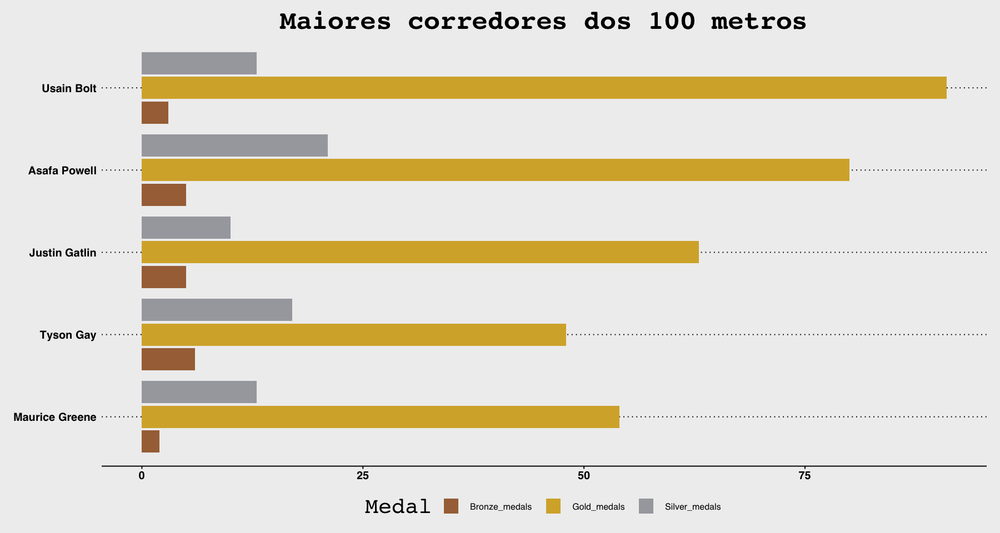

In [112]:
ggplot(data = performance_runners_men, mapping = aes(x = reorder(Name,Count), y = Count,fill = Medal)) + 
geom_bar(stat = "identity",position = "dodge2") + coord_flip() + theme_wsj(color = "gray") + scale_fill_manual(values = color_per_medal) +
labs(
    title = "Maiores corredores dos 100 metros"
) + theme(
    plot.title = element_text(hjust = 0.5),
    legend.position = "bottom"
)

In [113]:
runners_women100m <- runners_women |>
filter(Event == "100 m") |>
filter(Place == 1 | Place == 2 | Place == 3) |>
count(Name,sort = TRUE)

top_100m_women <- head(runners_women100m,5)
top_100m_women_list <- as.list(top_100m_women$Name)

In [114]:
performance_runners_women <- runners_women |>
group_by(Name) |>
filter(Year <= 2016) |>
summarise(
    Gold_medals = sum(Place == 1,na.rm = TRUE),
    Silver_medals = sum(Place == 2,na.rm = TRUE),
    Bronze_medals = sum(Place == 3,na.rm = TRUE),
    Total = Gold_medals + Silver_medals + Bronze_medals
)

In [115]:
head(performance_runners_women)
top_100m_women_list

Name,Gold_medals,Silver_medals,Bronze_medals,Total
<chr>,<int>,<int>,<int>,<int>
Ababel Yeshaneh,0,1,0,1
Abeba Aregawi,5,3,0,8
Abebe Arigawi,5,1,2,8
Abebe Tola,0,0,0,0
Abebech Afework,1,1,1,3
Abebu Gelan,0,0,0,0


[[1]]
[1] "Merlene Ottey"

[[2]]
[1] "Veronica Campbell-Brown"

[[3]]
[1] "Carmelita Jeter"

[[4]]
[1] "Gwen Torrence"

[[5]]
[1] "Marion Jones"

In [116]:
performance_runners_women <- performance_runners_women |>
pivot_longer(
  cols = c(Gold_medals, Silver_medals, Bronze_medals),
  names_to = "Medal",
  values_to = "Count"
)
performance_runners_women <-as.data.frame(performance_runners_women)
performance_runners_women <- performance_runners_women |> filter(Name %in% top_100m_women_list)

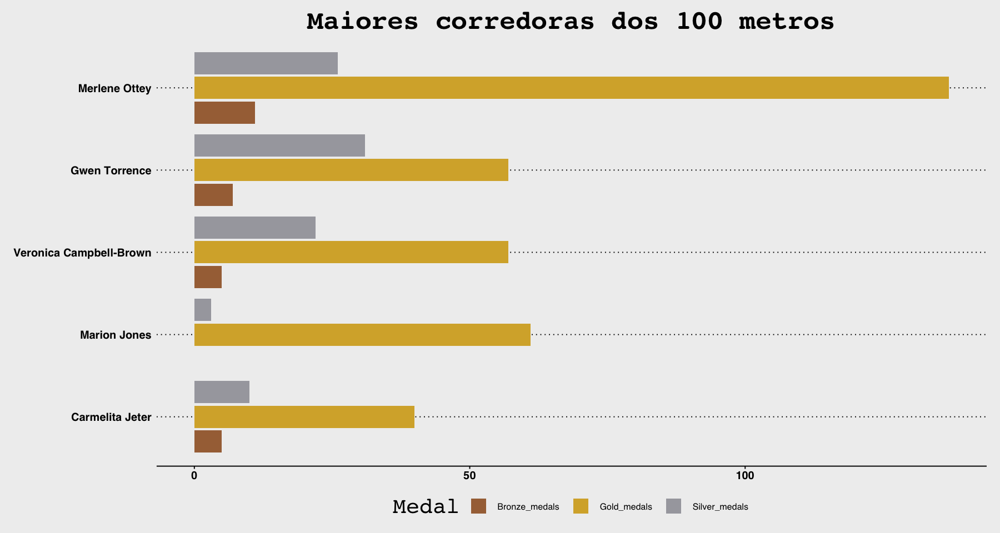

In [117]:
ggplot(data = performance_runners_women, mapping = aes(x = reorder(Name,Count), y = Count,fill = Medal)) + 
geom_bar(stat = "identity",position = "dodge2") + coord_flip()  + theme_wsj(color = "gray") + scale_fill_manual(values = color_per_medal) +
labs(
    title = "Maiores corredoras dos 100 metros"
) + theme(
    plot.title = element_text(hjust = 0.5),
    legend.position = "bottom"
)

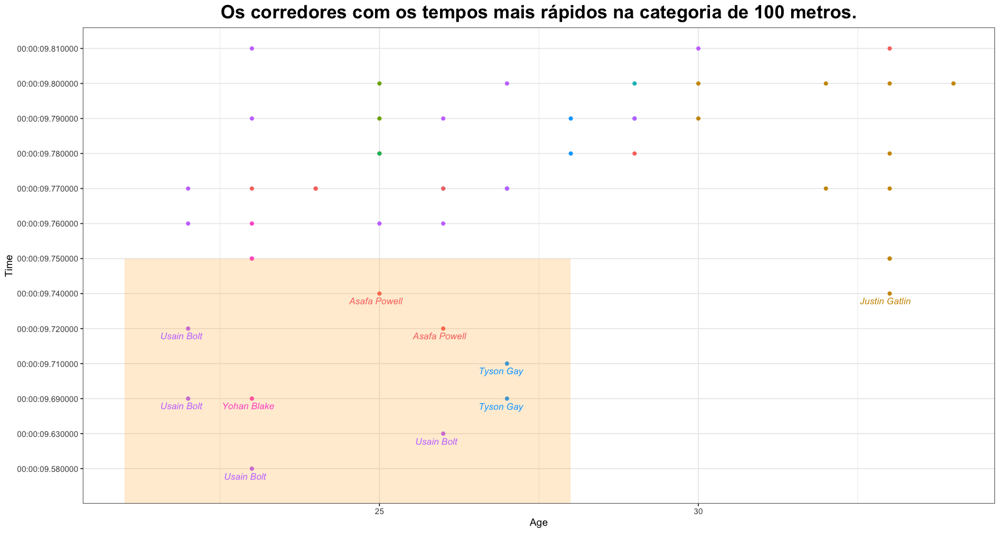

In [118]:
fastest_time_100m_men <- runners_men |>
filter(Event == "100 m") |>
arrange(Time)
top_50_fastest_time_100m_men <- head(fastest_time_100m_men,50)

ggplot(data = top_50_fastest_time_100m_men, mapping = aes(x = Age,y = Time,color = Name)) + geom_point(mapping = aes(group = Name))  +
annotate(
    geom = "rect", xmin = 21, xmax = 28,
    ymin = 0, ymax = 7, fill = "orange", alpha = 0.2
) + theme_bw() + guides(color =  FALSE) +
geom_text_repel(data = subset(top_50_fastest_time_100m_men, Time <= "00:00:09.740000"), mapping = aes(label = Name),size = 3.5, vjust = 0.2,hjust = 0.2,fontface = "italic") +
labs(
    title = "Os corredores com os tempos mais rápidos na categoria de 100 metros."
) + theme(
    plot.title = element_text(hjust = 0.5,size = 20,face = "bold"),
    legend.position = "bottom"
)



## Melhores competidores das maratonas

In [119]:
head(
runners_men |>
filter(Event == "Marathon") |>
filter(Place == 1 | Place == 2 | Place == 3) |>
count(Name,sort = TRUE, .keep = Time)
,3)

,Name,.keep,n
,<chr>,<chr>,<int>
1,Abel Kirui,02:07:38,2
2,Paul Biwott,02:08:17,2
3,Abdelkader El Mouaziz,02:07:11,1


In [120]:
Abel_Kirui_runner <- subset(runners_data, Name == "Abel Kirui" & Event == "Marathon")

In [121]:
head(
runners_women |>
filter(Event == "Marathon") |>
filter(Place == 1 | Place == 2 | Place == 3) |>
count(Name,sort = TRUE, .keep = Time)
,3)

,Name,.keep,n
,<chr>,<chr>,<int>
1,Aselefech Mergia,02:25:32,2
2,Jelena Prokopcuka,02:24:07,2
3,Mare Dibaba,02:19:52,2


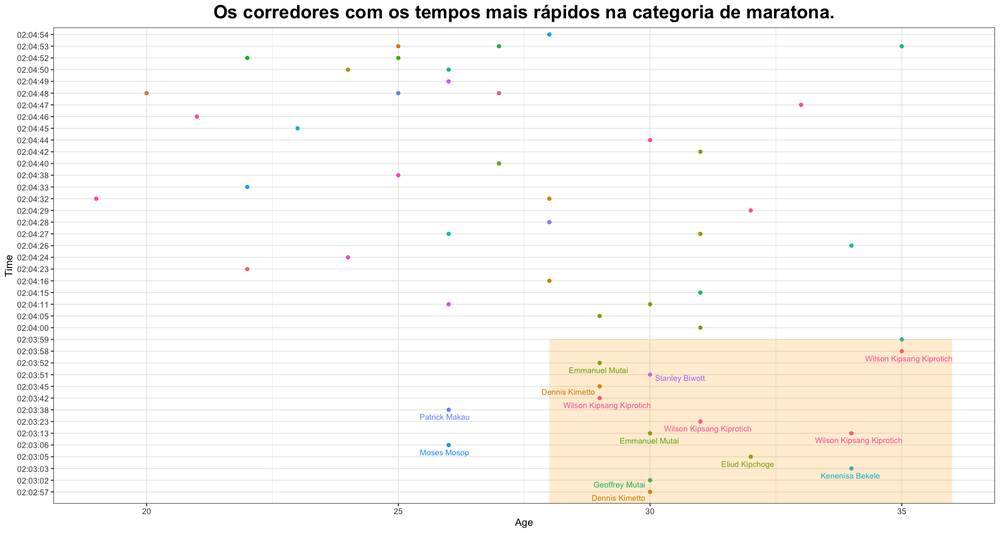

In [122]:
fastest_time_marathon_men <- runners_men |>
filter(Event == "Marathon") |>
arrange(Time)
top_50_fastest_time_marathon_men <- head(fastest_time_marathon_men,50)

ggplot(data = top_50_fastest_time_marathon_men, mapping = aes(x = Age, Time,color = Name)) + geom_point(mapping = aes(group = Name)) +
annotate(
    geom = "rect", xmin = 28, xmax = 36,
    ymin = 0, ymax = 14, fill = "orange", alpha = 0.2
    ) + theme_bw() + guides(color =  FALSE) +
geom_text_repel(data = subset(top_50_fastest_time_marathon_men, Time <= "02:03:58"), mapping = aes(label = Name),size = 3, vjust = 0.2,hjust = 0.2,) +
labs(
    title = "Os corredores com os tempos mais rápidos na categoria de maratona."
) + theme(
    plot.title = element_text(hjust = 0.5,size = 20,face = "bold"),
    legend.position = "bottom"
)


# Evolução dos corredores

In [123]:
performance_country_filtered <- head(performance_country$Country,3)
performance_country_filtered <- as.list(performance_country_filtered)
countries_performance_per_year <- runners_data |>
group_by(Country,Year) |>
filter(Place == 1 | Place == 2 | Place == 3, Year <= 2016) |>
count(Country,sort =  TRUE) |>
rename(total = n) 
top_countries_performance_per_year <- countries_performance_per_year |> filter(Country %in% performance_country_filtered)
head(top_countries_performance_per_year)

Country,Year,total
<chr>,<dbl>,<int>
KEN,2011,199
KEN,2012,198
KEN,2016,190
KEN,2014,183
KEN,2015,174
KEN,2010,168


In [124]:
top_countries_performance_per_year$Year

[1] 2011 2012 2016 2014 2015 2010 2015 2008 2013 2009 2007 1988 2013 1996 2012
 [16] 2006 2016 2007 2008 2012 2016 2013 2015 2009 2000 2010 2004 2014 2005 2006
 [31] 1999 2014 2004 1992 2000 2002 2011 2003 2001 1997 2005 1999 2010 2011 1997
 [46] 1998 1991 2008 2009 1993 1994 1998 1996 1984 1995 2004 2003 2005 2007 1987
 [61] 1995 2002 2003 2006 1986 1985 1992 1990 1989 1983 1993 2000 2001 2001 1982
 [76] 1994 1989 1991 1998 1999 1981 1995 2002 1968 1996 1997 1990 1980 1979 1987
 [91] 1994 1993 1974 1977 1984 1988 1974 1976 1978 1992 1972 1975 1977 1975 1976
[106] 1982 1986 1967 1981 1982 1987 1988 1989 1991 1978 1979 1980 1981 1983 1985
[121] 1966 1969 1971 1973

In [125]:
top_countries_performance_per_year$Year <- as.numeric(top_countries_performance_per_year$Year)

In [126]:
top_countries_performance_per_year$Year

[1] 2011 2012 2016 2014 2015 2010 2015 2008 2013 2009 2007 1988 2013 1996 2012
 [16] 2006 2016 2007 2008 2012 2016 2013 2015 2009 2000 2010 2004 2014 2005 2006
 [31] 1999 2014 2004 1992 2000 2002 2011 2003 2001 1997 2005 1999 2010 2011 1997
 [46] 1998 1991 2008 2009 1993 1994 1998 1996 1984 1995 2004 2003 2005 2007 1987
 [61] 1995 2002 2003 2006 1986 1985 1992 1990 1989 1983 1993 2000 2001 2001 1982
 [76] 1994 1989 1991 1998 1999 1981 1995 2002 1968 1996 1997 1990 1980 1979 1987
 [91] 1994 1993 1974 1977 1984 1988 1974 1976 1978 1992 1972 1975 1977 1975 1976
[106] 1982 1986 1967 1981 1982 1987 1988 1989 1991 1978 1979 1980 1981 1983 1985
[121] 1966 1969 1971 1973

In [127]:
glimpse(top_countries_performance_per_year)

Rows: 124
Columns: 3
Groups: Country, Year [124]
$ Country <chr> "KEN", "KEN", "KEN", "KEN", "KEN", "KEN", "USA", "KEN", "KEN",…
$ Year    <dbl> 2011, 2012, 2016, 2014, 2015, 2010, 2015, 2008, 2013, 2009, 20…
$ total   <int> 199, 198, 190, 183, 174, 168, 166, 143, 143, 131, 123, 118, 11…


In [128]:
top_countries_performance_per_year$Year <- as.numeric(as.character(top_countries_performance_per_year$Year))

p <- ggplot(data = top_countries_performance_per_year, mapping = aes(x = Year, y = total, color = Country)) +
  geom_line(size = 2, alpha = 0.75) +
  transition_reveal(Year) +
  theme_wsj(color = "gray") +
  scale_color_brewer(palette = "Dark2")

animate(p, width = 1000, height = 800, fps = 10)


`geom_line()`: Each group consists of only one observation.
ℹ Do you need to adjust the group aesthetic?


`geom_line()`: Each group consists of only one observation.
ℹ Do you need to adjust the group aesthetic?


<img src="data:image/gif;base64,R0lGODlh6AMgA/UAAAEBAQwMDBMTExwcHCQkJCsrKzQ0NDs7O0NDQ0xMTFFRUVxcXGRkZGtr
a3Nzc3x8fNVyQdZ4SteAVIR+tlGmhoODg4yMjJOTk5ubm6SkpKurq7Ozs7u7u5/IuZeSwLfU
ycTExMzMzNPT09zc3OjZ0und2NTh3N7d5ODf5drj4OTk5OPo5+bp6Ovr6wAAAAAAAAAAAAAA
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAACH5BAQKAAAAIf8L
TkVUU0NBUEUyLjADAQAAACH/C0lDQ1JHQkcxMDEy/wAAB8hhcHBsAiAAAG1udHJSR0IgWFla
IAfZAAIAGQALABoAC2Fjc3BBUFBMAAAAAGFwcGwAAAAAAAAAAAAAAAAAAAAAAAD21gABAAAA
ANMtYXBwbAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA
C2Rlc2MAAAEIAAAAb2RzY20AAAF4AAAFimNwcnQAAAcEAAAAOHd0cHQAAAc8AAAAFHJYWVoA
AAdQAAAAFGdYWVoAAAdkAAAAFGJYWVoAAAd4AAAAFHJUUkMAAAeMAAAADmNoYWQAAAecAAAA
LGJUUkMAAAeMAAAADmdUUv9DAAAHjAAAAA5kZXNjAAAAAAAAABRHZW5lcmljIFJHQiBQcm9m
aWxlAAAAAAAAAAAAAAAUR2VuZXJpYyBSR0IgUHJvZmlsZQAAAAAAAAAAAAAAAAAAAAAAAAAA
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAbWx1YwAAAAAAAAAfAAAADHNrU0sAAAAo
AAABhGRhREsAAAAkAAABrGNhRVMAAAAkAAAB0HZpVk4AAAAkAAAB9HB0QlIAAAAmAAACGHVr
VUEAAAAqAAACPmZyRlUAAAAoAAACaGh1SFUAAAAoAAACkHpoVFcAAAASAAACuGtvS1IAAAAW
AAD/AspuYk5PAAAAJgAAAuBjc0NaAAAAIgAAAwZoZUlMAAAAHgAAAyhyb1JPAAAAJAAAA0Zk
ZURFAAAALAAAA2ppdElUAAAAKAAAA5ZzdlNFAAAAJgAAAuB6aENOAAAAEgAAA75qYUpQAAAA
GgAAA9BlbEdSAAAAIgAAA+pwdFBPAAAAJgAABAxubE5MAAAAKAAABDJlc0VTAAAAJgAABAx0
aFRIAAAAJAAABFp0clRSAAAAIgAABH5maUZJAAAAKAAABKBockhSAAAAKAAABMhwbFBMAAAA
LAAABPBydVJVAAAAIgAABRxlblVTAAAAJgAABT5hckVHAAAAJgAABWQA/1YBYQBlAG8AYgBl
AGMAbgD9ACAAUgBHAEIAIABwAHIAbwBmAGkAbABHAGUAbgBlAHIAZQBsACAAUgBHAEIALQBw
AHIAbwBmAGkAbABQAGUAcgBmAGkAbAAgAFIARwBCACAAZwBlAG4A6AByAGkAYwBDHqUAdQAg
AGgA7ABuAGgAIABSAEcAQgAgAEMAaAB1AG4AZwBQAGUAcgBmAGkAbAAgAFIARwBCACAARwBl
AG4A6QByAGkAYwBvBBcEMAQzBDAEOwRMBD0EOAQ5ACAEPwRABD4ERAQwBDkEOwAgAFIARwBC
AFAAcgBvAGYAaQBsACAAZwDpAG4A6QByAGkAcf8AdQBlACAAUgBWAEIAwQBsAHQAYQBsAOEA
bgBvAHMAIABSAEcAQgAgAHAAcgBvAGYAaQBskBp1KABSAEcAQoJyX2ljz4/wx3y8GAAgAFIA
RwBCACDVBLhc0wzHfABHAGUAbgBlAHIAaQBzAGsAIABSAEcAQgAtAHAAcgBvAGYAaQBsAE8A
YgBlAGMAbgD9ACAAUgBHAEIAIABwAHIAbwBmAGkAbAXkBegF1QXkBdkF3AAgAFIARwBCACAF
2wXcBdwF2QBQAHIAbwBmAGkAbAAgAFIARwBCACAAZwBlAG4AZQByAGkAYwBBAGwAbABnAGUA
bQBlAGkAbgBlAHMAIAD/UgBHAEIALQBQAHIAbwBmAGkAbABQAHIAbwBmAGkAbABvACAAUgBH
AEIAIABnAGUAbgBlAHIAaQBjAG9mbpAaAFIARwBCY8+P8GWHTvZOAIIsACAAUgBHAEIAIDDX
MO0w1TChMKQw6wOTA7UDvQO5A7oDzAAgA8ADwQO/A8YDrwO7ACAAUgBHAEIAUABlAHIAZgBp
AGwAIABSAEcAQgAgAGcAZQBuAOkAcgBpAGMAbwBBAGwAZwBlAG0AZQBlAG4AIABSAEcAQgAt
AHAAcgBvAGYAaQBlAGwOQg4bDiMORA4fDiUOTAAgAFIARwBCACAOFw4xDkgOJw5EDhsARwBl
/wBuAGUAbAAgAFIARwBCACAAUAByAG8AZgBpAGwAaQBZAGwAZQBpAG4AZQBuACAAUgBHAEIA
LQBwAHIAbwBmAGkAaQBsAGkARwBlAG4AZQByAGkBDQBrAGkAIABSAEcAQgAgAHAAcgBvAGYA
aQBsAFUAbgBpAHcAZQByAHMAYQBsAG4AeQAgAHAAcgBvAGYAaQBsACAAUgBHAEIEHgQxBEkE
OAQ5ACAEPwRABD4ERAQ4BDsETAAgAFIARwBCAEcAZQBuAGUAcgBpAGMAIABSAEcAQgAgAFAA
cgBvAGYAaQBsAGUGRQZEBkEAIAYqBjkGMQZKBkEAIABSAEcAQgAgBs8nBkQGOQYnBkUAAHRl
eHQAAAAAQ29weXJpZ2h0IDIwMDcgQXBwbGUgSW5jLiwgYWxsIHJpZ2h0cyByZXNlcnZlZC4A
WFlaIAAAAAAAAPNSAAEAAAABFs9YWVogAAAAAAAAdE0AAD3uAAAD0FhZWiAAAAAAAABadQAA
rHMAABc0WFlaIAAAAAAAACgaAAAVnwAAuDZjdXJ2AAAAAAAAAAEBzQAAc2YzMgAAAAAAAQxC
AAAF3v//8yYAAAeSAAD9kf//+6L///2jAAAD3AAAwGwALAAAAADoAyADAAb/wJZwSCwaj8ik
cslsOp/QqHRKrVqv2Kx2y+16v+CweEwum8/otHrNbrvf8Lh8Tq/b7/i8fs/v+/+AgYKDhIWG
h4iJiouMjY6PkJGSk5SVlpeYmZqbnJ2en6ChoqOkpaanqKmqq6ytrq+wsbKztLW2t7i5uru8
vb6/wMHCw8TFxsfIycrLzM3Oz9DR0tPU1dbX2Nna29zd3t/g4eLj5OXm5+jp6uvs7e7v8PHy
8/T19vf4+fr7/P3+/wADChxIsKDBgwgTKlzIsKHDhxAjSpy4ZAQHECpaZIwzgqLHjyAvWSAA
oGQABQEcwKkAIETIlzBjElKRAMCABhYYDCi5AE4D/wAaZAodSpTOAgAIOgoZsVMBko1aVEA1
8jNoFKmEWAzROoUFV05fi4odG4cDAAFTW2QAkKDIhgM7AxR4APVCgQIqhSgoQMCA0hYV+Frg
cCAAgAIbiogAcdQCiMcYiYw4QKCAAY0VCp8U4oCv5cQtHng+kBYJixSoU6tGbWJFExADCMhG
oOHugLscCHCtUMFJid/Agwd3ksDl5AwjZRNQOSCDkAsXwiZRcQLFievWUWjf7oTAkAoWWGhA
UOAAhxZeFyzwSra9ezEKAPQuouLAfCFHARxgoEAAAAIgCIFBAQBcJkQCBPgHGmAE7jRAYSW5
JGBJFFY4ABH1EWDYCPEF4P8fAAE+EJcB5zFYEgKlHfEBBSy26GKLHbx2QBEsqCCAECwIsNsD
TkQAwY9ABvmjBE4YEIIJBVjQggU8DlFCAASQANgETkxg5ZVYXumBEwEM8UAFLBhwQgscILAU
XyW8p+aaWhC4YBIsDVBiCyMcVcAQKhRYxE9ztgBCSQxkxCEAPQkhQgUPGEDoAw488IBzRtRk
QAAWdMTBBUP8GcBfLWwAgFNOrP

# A tibble: 100 × 7
   format width height colorspace matte filesize density
   <chr>  <int>  <int> <chr>      <lgl>    <int> <chr>  
 1 gif     1000    800 sRGB       TRUE         0 72x72  
 2 gif     1000    800 sRGB       TRUE         0 72x72  
 3 gif     1000    800 sRGB       TRUE         0 72x72  
 4 gif     1000    800 sRGB       TRUE         0 72x72  
 5 gif     1000    800 sRGB       TRUE         0 72x72  
 6 gif     1000    800 sRGB       TRUE         0 72x72  
 7 gif     1000    800 sRGB       TRUE         0 72x72  
 8 gif     1000    800 sRGB       TRUE         0 72x72  
 9 gif     1000    800 sRGB       TRUE         0 72x72  
10 gif     1000    800 sRGB       TRUE         0 72x72  
# ℹ 90 more rows

In [129]:
top_countries_performance_per_year$Year <- as.numeric(top_countries_performance_per_year$Year)

p <- ggplot(data = top_countries_performance_per_year, aes(x = Year, y = total, group = Country, color = Country)) +
  geom_line(size = 2, alpha = 0.75) +
  geom_segment(aes(xend = max(Year) + 1, yend = total), linetype = 2, color = 'grey') +
  geom_point(size = 2) +
  geom_text(aes(x = max(Year) + 1, label = Country), hjust = 0) +
  transition_reveal(Year) +
  coord_cartesian(clip = 'off') +
  labs(title = 'Total Performance by Country', y = 'Total') +
  theme_minimal() +
  theme(plot.margin = margin(5.5, 40, 5.5, 5.5)) + guides(color = FALSE)

animate(p, width = 1000, height = 700, fps = 10)


`geom_line()`: Each group consists of only one observation.
ℹ Do you need to adjust the group aesthetic?
`geom_line()`: Each group consists of only one observation.
ℹ Do you need to adjust the group aesthetic?


<img src="data:image/gif;base64,R0lGODlh6AO8AvYAAAICAgwMDBQUFBsbGyMjIywsLDIyMjs7O0RERExMTFRUVFtbW2RkZGtr
a3R0dHt7e1CG/1aK/1uN/1+Q/2WR9GOT/2mX/m6a/nSc93Se/Xeh/nqj/4ODg4yMjJSUlJub
m6SkpKurq7S0tLu7u4Gn/Yer/Yit/42w/5az95O0/Zm3+pu5/aK89q3D9KbB/6zG/7DI/7nN
/L7S/8bGxszMzNPT09zc3MTS8s7a98HU/8bY/8zc/9Td8NHf/9/k79zj8tTh/9nk/97o/+Xl
5eDl7+zs7O3v9eLr/env/+vx//Pz8/L2//f5/////wAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA
AAAAAAAAAAAAAAAAAAAAAAAAACH5BAQKAAAAIf8LTkVUU0NBUEUyLjADAQAAACH/C0lDQ1JH
QkcxMDEy/wAAB8hhcHBsAiAAAG1udHJSR0IgWFlaIAfZAAIAGQALABoAC2Fjc3BBUFBMAAAA
AGFwcGwAAAAAAAAAAAAAAAAAAAAAAAD21gABAAAAANMtYXBwbAAAAAAAAAAAAAAAAAAAAAAA
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAC2Rlc2MAAAEIAAAAb2RzY20AAAF4AAAF
imNwcnQAAAcEAAAAOHd0cHQAAAc8AAAAFHJYWVoAAAdQAAAAFGdYWVoAAAdkAAAAFGJYWVoA
AAd4AAAAFHJUUkMAAAeMAAAADmNoYWQAAAecAAAALGJUUkMAAAeMAAAADmdUUv9DAAAHjAAA
AA5kZXNjAAAAAAAAABRHZW5lcmljIFJHQiBQcm9maWxlAAAAAAAAAAAAAAAUR2VuZXJpYyBS
R0IgUHJvZmlsZQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA
AAAAAAAAbWx1YwAAAAAAAAAfAAAADHNrU0sAAAAoAAABhGRhREsAAAAkAAABrGNhRVMAAAAk
AAAB0HZpVk4AAAAkAAAB9HB0QlIAAAAmAAACGHVrVUEAAAAqAAACPmZyRlUAAAAoAAACaGh1
SFUAAAAoAAACkHpoVFcAAAASAAACuGtvS1IAAAAWAAD/AspuYk5PAAAAJgAAAuBjc0NaAAAA
IgAAAwZoZUlMAAAAHgAAAyhyb1JPAAAAJAAAA0ZkZURFAAAALAAAA2ppdElUAAAAKAAAA5Zz
dlNFAAAAJgAAAuB6aENOAAAAEgAAA75qYUpQAAAAGgAAA9BlbEdSAAAAIgAAA+pwdFBPAAAA
JgAABAxubE5MAAAAKAAABDJlc0VTAAAAJgAABAx0aFRIAAAAJAAABFp0clRSAAAAIgAABH5m
aUZJAAAAKAAABKBockhSAAAAKAAABMhwbFBMAAAALAAABPBydVJVAAAAIgAABRxlblVTAAAA
JgAABT5hckVHAAAAJgAABWQA/1YBYQBlAG8AYgBlAGMAbgD9ACAAUgBHAEIAIABwAHIAbwBm
AGkAbABHAGUAbgBlAHIAZQBsACAAUgBHAEIALQBwAHIAbwBmAGkAbABQAGUAcgBmAGkAbAAg
AFIARwBCACAAZwBlAG4A6AByAGkAYwBDHqUAdQAgAGgA7ABuAGgAIABSAEcAQgAgAEMAaAB1
AG4AZwBQAGUAcgBmAGkAbAAgAFIARwBCACAARwBlAG4A6QByAGkAYwBvBBcEMAQzBDAEOwRM
BD0EOAQ5ACAEPwRABD4ERAQwBDkEOwAgAFIARwBCAFAAcgBvAGYAaQBsACAAZwDpAG4A6QBy
AGkAcf8AdQBlACAAUgBWAEIAwQBsAHQAYQBsAOEAbgBvAHMAIABSAEcAQgAgAHAAcgBvAGYA
aQBskBp1KABSAEcAQoJyX2ljz4/wx3y8GAAgAFIARwBCACDVBLhc0wzHfABHAGUAbgBlAHIA
aQBzAGsAIABSAEcAQgAtAHAAcgBvAGYAaQBsAE8AYgBlAGMAbgD9ACAAUgBHAEIAIABwAHIA
bwBmAGkAbAXkBegF1QXkBdkF3AAgAFIARwBCACAF2wXcBdwF2QBQAHIAbwBmAGkAbAAgAFIA
RwBCACAAZwBlAG4AZQByAGkAYwBBAGwAbABnAGUAbQBlAGkAbgBlAHMAIAD/UgBHAEIALQBQ
AHIAbwBmAGkAbABQAHIAbwBmAGkAbABvACAAUgBHAEIAIABnAGUAbgBlAHIAaQBjAG9mbpAa
AFIARwBCY8+P8GWHTvZOAIIsACAAUgBHAEIAIDDXMO0w1TChMKQw6wOTA7UDvQO5A7oDzAAg
A8ADwQO/A8YDrwO7ACAAUgBHAEIAUABlAHIAZgBpAGwAIABSAEcAQgAgAGcAZQBuAOkAcgBp
AGMAbwBBAGwAZwBlAG0AZQBlAG4AIABSAEcAQgAtAHAAcgBvAGYAaQBlAGwOQg4bDiMORA4f
DiUOTAAgAFIARwBCACAOFw4xDkgOJw5EDhsARwBl/wBuAGUAbAAgAFIARwBCACAAUAByAG8A
ZgBpAGwAaQBZAGwAZQBpAG4AZQBuACAAUgBHAEIALQBwAHIAbwBmAGkAaQBsAGkARwBlAG4A
ZQByAGkBDQBrAGkAIABSAEcAQgAgAHAAcgBvAGYAaQBsAFUAbgBpAHcAZQByAHMAYQBsAG4A
eQAgAHAAcgBvAGYAaQBsACAAUgBHAEIEHgQxBEkEOAQ5ACAEPwRABD4ERAQ4BDsETAAgAFIA
RwBCAEcAZQBuAGUAcgBpAGMAIABSAEcAQgAgAFAAcgBvAGYAaQBsAGUGRQZEBkEAIAYqBjkG
MQZKBkEAIABSAEcAQgAgBs8nBkQGOQYnBkUAAHRleHQAAAAAQ29weXJpZ2h0IDIwMDcgQXBw
bGUgSW5jLiwgYWxsIHJpZ2h0cyByZXNlcnZlZC4AWFlaIAAAAAAAAPNSAAEAAAABFs9YWVog
AAAAAAAAdE0AAD3uAAAD0FhZWiAAAAAAAABadQAArHMAABc0WFlaIAAAAAAAACgaAAAVnwAA
uDZjdXJ2AAAAAAAAAAEBzQAAc2YzMgAAAAAAAQxCAAAF3v//8yYAAAeSAAD9kf//+6L///2j
AAAD3AAAwGwALAAAAADoA7wCAAf/gE2Cg4SFhoeIiYqLjI2Oj5CRkpOUlZaXmJmam5ydnp+g
oaKjpKWmp6ipqqusra6vsLGys7S1tre4ubq7vL2+v8DBwsPExcbHyMnKy8zNzs/Q0dLT1NXW
19jZ2tvc3d7f4OHi49giHefoIIlKiSA1hegdH++OHw0ztkodkkoiDx9DNLEjR7CgwYMIEyo8
1EGBAgIDHDpA5GEiogIhCgFA4BABgAeNQAh4QI+WDQADHdkYUMBBggAeMFVcSLOmzZs4c/pq
oGBRgwaJMGocMQgEgCKMHvS8dRJSEQIWm4gIYOPST51Ys2rdyrVrI56EajAQQEAdiAACGEg1
EGAA0CYF/9QRAkBUUA0AVUEQCIDg3ZADDwQsEBCgQJMaDch+EJSgw4AFHxwMNmBjbAJ6D/YK
HWLgAwEBb5s0IFCAg10EAcoWOslhwICYIwwMmjlIhIBCIQIW4VBgAAN2Ht4+VfLXM+gmH9Ay
sIEgMAfZgmh7nU69uvXrzsAKGjKyyNmMDH4XAZBxBgARcDPOrVtjwYEmIwKIKPJggJKTCkTY
cKBASREBDhQRgnxNGECACDN0AAAIQ6DWQREKTOSZDUo8EEAT+NkwQwBEMXDADDYQEIISAzwg
oAB1CXJSAjZMhR6Kggg1yAMIIK

# A tibble: 100 × 7
   format width height colorspace matte filesize density
   <chr>  <int>  <int> <chr>      <lgl>    <int> <chr>  
 1 gif     1000    700 sRGB       TRUE         0 72x72  
 2 gif     1000    700 sRGB       TRUE         0 72x72  
 3 gif     1000    700 sRGB       TRUE         0 72x72  
 4 gif     1000    700 sRGB       TRUE         0 72x72  
 5 gif     1000    700 sRGB       TRUE         0 72x72  
 6 gif     1000    700 sRGB       TRUE         0 72x72  
 7 gif     1000    700 sRGB       TRUE         0 72x72  
 8 gif     1000    700 sRGB       TRUE         0 72x72  
 9 gif     1000    700 sRGB       TRUE         0 72x72  
10 gif     1000    700 sRGB       TRUE         0 72x72  
# ℹ 90 more rows

In [130]:
top_countries_performance_per_year$Year <- as.numeric(top_countries_performance_per_year$Year)

p <- ggplot(data = top_countries_performance_per_year, aes(x = Year, y = total, group = Country, color = Country)) +
  geom_line(size = 2, alpha = 0.75) +
  geom_segment(aes(xend = max(Year) + 1, yend = total), linetype = 2, color = 'grey') +
  geom_point(size = 2) +
  geom_text(aes(x = max(Year) + 1, label = Country), hjust = 0) +
  transition_reveal(Year) +
  coord_cartesian(clip = 'off') +
  labs(title = 'Total Performance by Country', y = 'Total') +
  theme_minimal() +
  theme(plot.margin = margin(5.5, 40, 5.5, 5.5)) +
  guides(color = FALSE)

animate(p, width = 1000, height = 700, fps = 10, nframes = 200)


`geom_line()`: Each group consists of only one observation.
ℹ Do you need to adjust the group aesthetic?
`geom_line()`: Each group consists of only one observation.
ℹ Do you need to adjust the group aesthetic?


<img src="data:image/gif;base64,R0lGODlh6AO8AvYAAAICAgwMDBQUFBsbGyMjIywsLDIyMjs7O0RERExMTFRUVFtbW2RkZGtr
a3R0dHt7e1CG/1aK/1uN/1+Q/2WR9GOT/2mX/m6a/nSc93Se/Xeh/nqj/4ODg4yMjJSUlJub
m6SkpKurq7S0tLu7u4Gn/Yer/Yit/42w/5az95O0/Zm3+pu5/aK89q3D9KbB/6zG/7DI/7nN
/L7S/8bGxszMzNPT09zc3MTS8s7a98HU/8bY/8zc/9Td8NHf/9/k79zj8tTh/9nk/97o/+Xl
5eDl7+zs7O3v9eLr/env/+vx//Pz8/L2//f5/////wAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA
AAAAAAAAAAAAAAAAAAAAAAAAACH5BAQKAAAAIf8LTkVUU0NBUEUyLjADAQAAACH/C0lDQ1JH
QkcxMDEy/wAAB8hhcHBsAiAAAG1udHJSR0IgWFlaIAfZAAIAGQALABoAC2Fjc3BBUFBMAAAA
AGFwcGwAAAAAAAAAAAAAAAAAAAAAAAD21gABAAAAANMtYXBwbAAAAAAAAAAAAAAAAAAAAAAA
AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAC2Rlc2MAAAEIAAAAb2RzY20AAAF4AAAF
imNwcnQAAAcEAAAAOHd0cHQAAAc8AAAAFHJYWVoAAAdQAAAAFGdYWVoAAAdkAAAAFGJYWVoA
AAd4AAAAFHJUUkMAAAeMAAAADmNoYWQAAAecAAAALGJUUkMAAAeMAAAADmdUUv9DAAAHjAAA
AA5kZXNjAAAAAAAAABRHZW5lcmljIFJHQiBQcm9maWxlAAAAAAAAAAAAAAAUR2VuZXJpYyBS
R0IgUHJvZmlsZQAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA
AAAAAAAAbWx1YwAAAAAAAAAfAAAADHNrU0sAAAAoAAABhGRhREsAAAAkAAABrGNhRVMAAAAk
AAAB0HZpVk4AAAAkAAAB9HB0QlIAAAAmAAACGHVrVUEAAAAqAAACPmZyRlUAAAAoAAACaGh1
SFUAAAAoAAACkHpoVFcAAAASAAACuGtvS1IAAAAWAAD/AspuYk5PAAAAJgAAAuBjc0NaAAAA
IgAAAwZoZUlMAAAAHgAAAyhyb1JPAAAAJAAAA0ZkZURFAAAALAAAA2ppdElUAAAAKAAAA5Zz
dlNFAAAAJgAAAuB6aENOAAAAEgAAA75qYUpQAAAAGgAAA9BlbEdSAAAAIgAAA+pwdFBPAAAA
JgAABAxubE5MAAAAKAAABDJlc0VTAAAAJgAABAx0aFRIAAAAJAAABFp0clRSAAAAIgAABH5m
aUZJAAAAKAAABKBockhSAAAAKAAABMhwbFBMAAAALAAABPBydVJVAAAAIgAABRxlblVTAAAA
JgAABT5hckVHAAAAJgAABWQA/1YBYQBlAG8AYgBlAGMAbgD9ACAAUgBHAEIAIABwAHIAbwBm
AGkAbABHAGUAbgBlAHIAZQBsACAAUgBHAEIALQBwAHIAbwBmAGkAbABQAGUAcgBmAGkAbAAg
AFIARwBCACAAZwBlAG4A6AByAGkAYwBDHqUAdQAgAGgA7ABuAGgAIABSAEcAQgAgAEMAaAB1
AG4AZwBQAGUAcgBmAGkAbAAgAFIARwBCACAARwBlAG4A6QByAGkAYwBvBBcEMAQzBDAEOwRM
BD0EOAQ5ACAEPwRABD4ERAQwBDkEOwAgAFIARwBCAFAAcgBvAGYAaQBsACAAZwDpAG4A6QBy
AGkAcf8AdQBlACAAUgBWAEIAwQBsAHQAYQBsAOEAbgBvAHMAIABSAEcAQgAgAHAAcgBvAGYA
aQBskBp1KABSAEcAQoJyX2ljz4/wx3y8GAAgAFIARwBCACDVBLhc0wzHfABHAGUAbgBlAHIA
aQBzAGsAIABSAEcAQgAtAHAAcgBvAGYAaQBsAE8AYgBlAGMAbgD9ACAAUgBHAEIAIABwAHIA
bwBmAGkAbAXkBegF1QXkBdkF3AAgAFIARwBCACAF2wXcBdwF2QBQAHIAbwBmAGkAbAAgAFIA
RwBCACAAZwBlAG4AZQByAGkAYwBBAGwAbABnAGUAbQBlAGkAbgBlAHMAIAD/UgBHAEIALQBQ
AHIAbwBmAGkAbABQAHIAbwBmAGkAbABvACAAUgBHAEIAIABnAGUAbgBlAHIAaQBjAG9mbpAa
AFIARwBCY8+P8GWHTvZOAIIsACAAUgBHAEIAIDDXMO0w1TChMKQw6wOTA7UDvQO5A7oDzAAg
A8ADwQO/A8YDrwO7ACAAUgBHAEIAUABlAHIAZgBpAGwAIABSAEcAQgAgAGcAZQBuAOkAcgBp
AGMAbwBBAGwAZwBlAG0AZQBlAG4AIABSAEcAQgAtAHAAcgBvAGYAaQBlAGwOQg4bDiMORA4f
DiUOTAAgAFIARwBCACAOFw4xDkgOJw5EDhsARwBl/wBuAGUAbAAgAFIARwBCACAAUAByAG8A
ZgBpAGwAaQBZAGwAZQBpAG4AZQBuACAAUgBHAEIALQBwAHIAbwBmAGkAaQBsAGkARwBlAG4A
ZQByAGkBDQBrAGkAIABSAEcAQgAgAHAAcgBvAGYAaQBsAFUAbgBpAHcAZQByAHMAYQBsAG4A
eQAgAHAAcgBvAGYAaQBsACAAUgBHAEIEHgQxBEkEOAQ5ACAEPwRABD4ERAQ4BDsETAAgAFIA
RwBCAEcAZQBuAGUAcgBpAGMAIABSAEcAQgAgAFAAcgBvAGYAaQBsAGUGRQZEBkEAIAYqBjkG
MQZKBkEAIABSAEcAQgAgBs8nBkQGOQYnBkUAAHRleHQAAAAAQ29weXJpZ2h0IDIwMDcgQXBw
bGUgSW5jLiwgYWxsIHJpZ2h0cyByZXNlcnZlZC4AWFlaIAAAAAAAAPNSAAEAAAABFs9YWVog
AAAAAAAAdE0AAD3uAAAD0FhZWiAAAAAAAABadQAArHMAABc0WFlaIAAAAAAAACgaAAAVnwAA
uDZjdXJ2AAAAAAAAAAEBzQAAc2YzMgAAAAAAAQxCAAAF3v//8yYAAAeSAAD9kf//+6L///2j
AAAD3AAAwGwALAAAAADoA7wCAAf/gE2Cg4SFhoeIiYqLjI2Oj5CRkpOUlZaXmJmam5ydnp+g
oaKjpKWmp6ipqqusra6vsLGys7S1tre4ubq7vL2+v8DBwsPExcbHyMnKy8zNzs/Q0dLT1NXW
19jZ2tvc3d7f4OHi49giHefoIIlKiSA1hegdH++OHw0ztkodkkoiDx9DNLEjR7CgwYMIEyo8
1EGBAgIDHDpA5GEiogIhCgFA4BABgAeNQAh4QI+WDQADHdkYUMBBggAeMFVcSLOmzZs4c/pq
oGBRgwaJMGocMQgEgCKMHvS8dRJSEQIWm4gIYOPST51Ys2rdyrVrI56EajAQQEAdiAACGEg1
EGAA0CYF/9QRAkBUUA0AVUEQCIDg3ZADDwQsEBCgQJMaDch+EJSgw4AFHxwMNmBjbAJ6D/YK
HWLgAwEBb5s0IFCAg10EAcoWOslhwICYIwwMmjlIhIBCIQIW4VBgAAN2Ht4+VfLXM+gmH9Ay
sIEgMAfZgmh7nU69uvXrzsAKGjKyyNmMDH4XAZBxBgARcDPOrVtjwYEmIwKIKPJggJKTCkTY
cKBASREBDhQRgnxNGECACDN0AAAIQ6DWQREKTOSZDUo8EEAT+NkwQwBEMXDADDYQEIISAzwg
oAB1CXJSAjZMhR6Kggg1yAMIIK

# A tibble: 200 × 7
   format width height colorspace matte filesize density
   <chr>  <int>  <int> <chr>      <lgl>    <int> <chr>  
 1 gif     1000    700 sRGB       TRUE         0 72x72  
 2 gif     1000    700 sRGB       TRUE         0 72x72  
 3 gif     1000    700 sRGB       TRUE         0 72x72  
 4 gif     1000    700 sRGB       TRUE         0 72x72  
 5 gif     1000    700 sRGB       TRUE         0 72x72  
 6 gif     1000    700 sRGB       TRUE         0 72x72  
 7 gif     1000    700 sRGB       TRUE         0 72x72  
 8 gif     1000    700 sRGB       TRUE         0 72x72  
 9 gif     1000    700 sRGB       TRUE         0 72x72  
10 gif     1000    700 sRGB       TRUE         0 72x72  
# ℹ 190 more rows